In [1]:
import os
if 'examples' in os.getcwd(): os.chdir('../')
print(os.getcwd())

/home/bernie40916/Nas/home/Project/DJtransGAN-dg-pipeline


In [2]:
import warnings
warnings.filterwarnings('ignore')

In [3]:
import torch
import matplotlib.pyplot as plt

from pipleine.config  import settings
from pipeline.feature import estimate_feature, keynum_to_keylabel
from pipeline.utils   import load_audio, load_json, find_nearest, find_index
from pipeline.utils   import time_to_str, str_to_time
from pipeline.utils   import wave_visualize, audio_visualize

### Load Data

In [4]:
audio_dir = os.path.join(settings.MIX_DIR, 'audio')
meta_json = load_json(os.path.join(settings.MIX_DIR, 'meta.json'))

In [5]:
mix_id     = list(meta_json.keys())[0]
cue        = meta_json[mix_id]['cue']
audio_path = os.path.join(audio_dir, f'{mix_id}.wav')
audio      = load_audio(audio_path)

### Feature Extraction

In [6]:
feature    = estimate_feature(audio_path)
sig, bpm, beat, downbeat = feature['beat']
key_num, style  = feature['key']
boundary, label = feature['structure']

### Extract Cue Points

In [7]:
cue_out_idx = find_nearest(downbeat, cue)
cue_in_idx  = cue_out_idx-settings.CUE_BAR
cue_points  = [downbeat[cue_out_idx], downbeat[cue_in_idx]]

print('cue points: ', cue_points)

cue points:  [238.05, 222.69]


### Visualize

In [8]:
print('key: ', keynum_to_keylabel((key_num, style)))
print('bpm: ', f'{bpm:.4}')
print('sig: ', f'{sig[0]}/{sig[1]}')

key:  G minor
bpm:  125.0
sig:  4/4


3:58.05
3:42.69


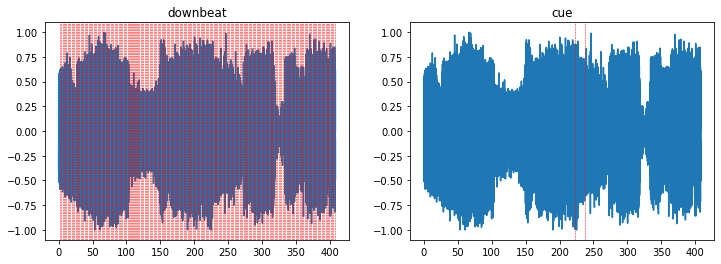

In [9]:
audio_visualize(audio)
fig, axs = plt.subplots(1, 2, figsize=(12, 4))
wave_visualize(audio, axs[0], title='downbeat', timestamps=downbeat)
wave_visualize(audio, axs[1], title='cue'     , timestamps=cue_points)

for cue_point in cue_points:
    print(time_to_str(cue_point))